# Persipkan environment YOLOv8


Membuat direktori root

Membuat direktori dataset menggunakan perintah `mkdir` dan masuk direktori dataset meggunakan perintah `cd`

In [1]:
!mkdir food_detection
%cd food_detection

/content/food_detection


Clone *source code* YOLOv8 dari Github.

In [2]:
!git clone https://github.com/ultralytics/ultralytics

Cloning into 'ultralytics'...
remote: Enumerating objects: 10333, done.
remote: Counting objects: 100% (2454/2454), done.
remote: Compressing objects: 100% (1106/1106), done.
remote: Total 10333 (delta 1693), reused 1965 (delta 1344), pack-reused 7879
Receiving objects: 100% (10333/10333), 6.37 MiB | 12.47 MiB/s, done.
Resolving deltas: 100% (7018/7018), done.


Install semua daftar dependency/package Python yang diperlukan

In [3]:
%cd ultralytics
!pip install -r requirements.txt # install dependencies

/content/food_detection/ultralytics
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Install roboflow package menggunakan `pip`

In [4]:
%pip install -q roboflow

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 kB 4.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 8.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 7.4 MB/s eta 0:00:00


# Persiapan Dataset

In [5]:
import os

os.environ["DATASET_DIRECTORY"] = "/content/food_detection/datasets"

Download dataset menggunakan `API Roboflow`

In [6]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="GWstKR3lq9zg6NozrKMX")
project = rf.workspace("nutriscan").project("tesnutriscan")
dataset = project.version(1).download("yolov8")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics<=8.0.20 is required but found version=8.0.110, to fix: `pip install ultralytics<=8.0.20`


Extracting Dataset Version Zip to /content/food_detection/datasets/TesNutriscan-1 in yolov8:: 100%|██████████| 12034/12034 [00:02<00:00, 4709.45it/s]


Periksa total kategori/class pada anotasi ground-truth dari dataset

In [7]:
from glob import glob

labels_train = glob("/content/food_detection/datasets/TesNutriscan-1/train/labels/*.txt")
amount_per_class = {}

for i in range(len(labels_train)):
  f = open(labels_train[i], "r")
  for anotate in f:
      if anotate[0] not in amount_per_class.keys():
        amount_per_class[anotate[0]] = 1
      else:
        amount_per_class[anotate[0]] += 1

print(f"Jumlah total objek pada train: {sum(amount_per_class.values())}")
print(f'Jumlah objek per class pada train: {amount_per_class}')

Jumlah total objek pada train: 9507
Jumlah objek per class pada train: {'5': 1899, '1': 1293, '4': 1401, '6': 1059, '2': 1335, '7': 174, '3': 1770, '9': 429, '8': 147}


In [8]:
labels_valid = glob("/content/food_detection/datasets/TesNutriscan-1/valid/labels/*.txt")
amount_per_class = {}

for i in range(len(labels_valid)):
  f = open(labels_valid[i], "r")
  for anotate in f:
      if anotate[0] not in amount_per_class.keys():
        amount_per_class[anotate[0]] = 1
      else:
        amount_per_class[anotate[0]] += 1

print(f"Jumlah total objek pada train: {sum(amount_per_class.values())}")
print(f'Jumlah objek per class pada train: {amount_per_class}')

Jumlah total objek pada train: 1133
Jumlah objek per class pada train: {'2': 157, '3': 209, '1': 203, '6': 102, '4': 159, '5': 227, '9': 50, '7': 8, '8': 16, '0': 2}


Membuat `dataset.yaml` untuk menyimpan konfigurasi dataset yang akan di training

In [9]:
%cd /content/food_detection

/content/food_detection


## Persiapan *working directory* dan *training resources*

PROSES TRAIN

In [11]:
from ultralytics import YOLO

# Load a model
model = YOLO("yolov8s.yaml")  # build a new model from scratch
model = YOLO("yolov8s.pt")  # load a pretrained model (recommended for training)
# Use the model
model.train(data="/content/food_detection/datasets/TesNutriscan-1/data.yaml", epochs=30)  # train the model
metrics = model.val()  # evaluate model performance on the validation set
success = model.export(format="onnx")  # export the model to ONNX format


                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics.nn.modules.conv.Conv             [256

============= Diagnostic Run torch.onnx.export version 2.0.1+cu118 =============
verbose: False, log level: Level.ERROR
======================= 0 NONE 0 NOTE 0 WARNING 0 ERROR ========================



Setelah proses training selesai, kita juga akan mendapatkan beberapa gambar yang secara otomatis disimpan oleh script dari YOLOv8 untuk mengevaluasi hasil training. Salah satu yang paling penting adalah file `results.png`

**Model Val**

Melakukan validasi menggunakan data pada validasi. Untuk proses validasi sebenarnya sudah dilakukan ketika training diakhir, tetapi apabila ingin memvalidasi dengan data validasi baru dapat menggunakan perintah `model.val()`

In [12]:
results = model.val()

Ultralytics YOLOv8.0.110 🚀 Python-3.10.11 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
val: Scanning /content/food_detection/datasets/TesNutriscan-1/valid/labels.cache... 543 images, 0 backgrounds, 0 corrupt: 100%|██████████| 543/543 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:12<00:00,  2.68it/s]
                   all        543       1133      0.599      0.588      0.608      0.371
                    13        543          2          0          0          0          0
                    14        543          1          0          0          0          0
                  apel        543          8      0.701      0.625      0.686      0.607
                  arem        543         16      0.488      0.562      0.521      0.187
                  ayam        543         50      0.352        0.4      0.365      0.163
                bakpia        543         11      0.474      0.455      0.53

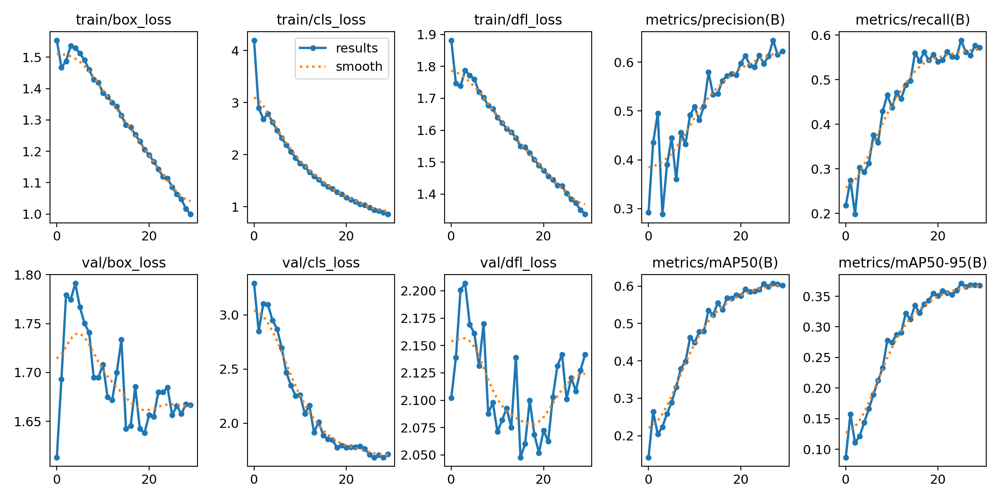

In [13]:
from IPython.display import Image
Image(filename='/content/food_detection/ultralytics/runs/detect/train2/results.png')

## Mencoba hasil training

Melakukan deteksi pada beberapa gambar pada dataset validation

In [14]:
results = model.track('/content/food_detection/datasets/TesNutriscan-1/test/images', save=True)

requirements: Ultralytics requirement "lap>=0.4" not found, attempting AutoUpdate...
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 18.2 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for lap: filename=lap-0.4.0-cp310-cp310-linux_x86_64.whl size=1655219 sha256=675aaee7182470c303f652d069200761d4ef855ff765ce06e6c405ae0086cbe3
  Stored in directory: /tmp/pip-ephem-wheel-cache-x9k2chbu/wheels/00/42/2e/9dfe19270eea279d79e84767ff0d7b8082c3bf776cad00e83d
Successfully built lap

requirements: 1 package updated per ['lap>=0.4']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect


image 1/587 /content/food_detection/datasets/TesNutriscan-1/test/images/101_jpg.rf.c29dc1c93f5cc6218714dc6c40c07db1.jpg: 640x640 1 batagor, 16.5ms
image 2/587 /content/food_detection/datasets/TesNutr

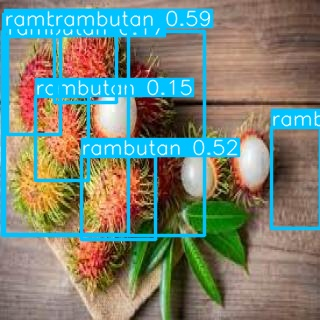

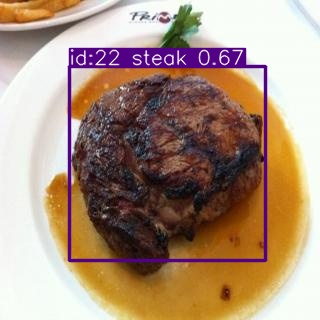

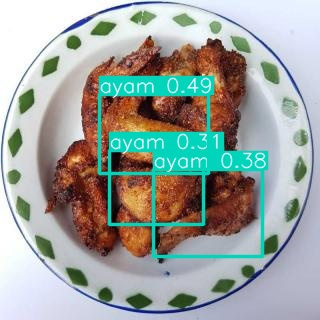

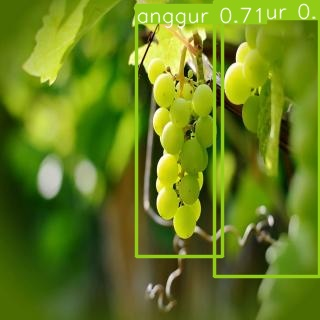

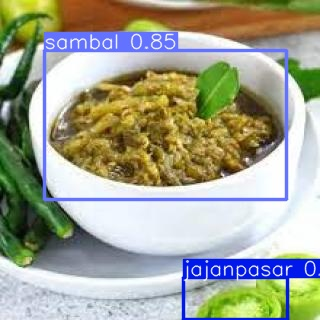

...

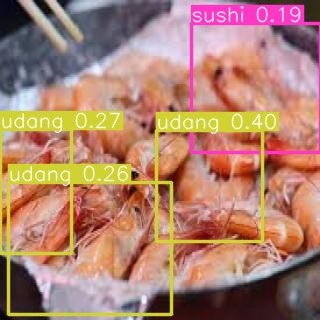

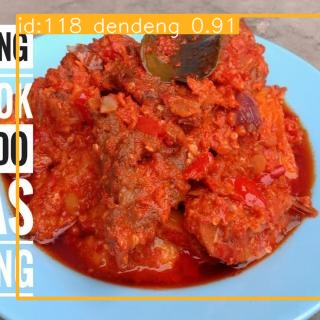

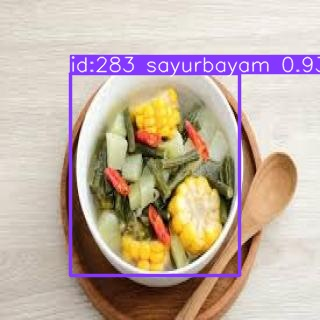

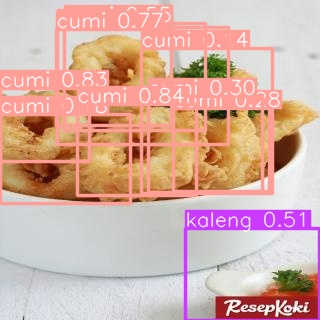

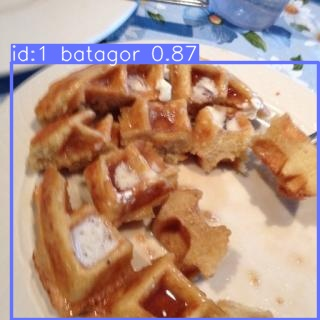

In [15]:
from IPython.display import Image, display
import glob

for imageName in glob.glob('/content/food_detection/ultralytics/runs/detect/track/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

Download model YOLOv8

In [16]:
from google.colab import files
files.download('/content/food_detection/ultralytics/runs/detect/train2/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [25]:
from ultralytics import YOLO

# Load a model
model = YOLO('yolov8s.pt')  # load an official model
model = YOLO('/content/food_detection/ultralytics/runs/detect/train2/weights/best.pt')  # load a custom trained

# Export the model
model.export(format='tflite')


Ultralytics YOLOv8.0.110 🚀 Python-3.10.11 torch-2.0.1+cu118 CPU
Model summary (fused): 168 layers, 11151126 parameters, 0 gradients

PyTorch: starting from /content/food_detection/ultralytics/runs/detect/train2/weights/best.pt with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 70, 8400) (21.5 MB)

TensorFlow SavedModel: starting export with tensorflow 2.12.0...

ONNX: starting export with onnx 1.14.0 opset 17...
ONNX: simplifying with onnxsim 0.4.28...


============= Diagnostic Run torch.onnx.export version 2.0.1+cu118 =============
verbose: False, log level: Level.ERROR
======================= 0 NONE 0 NOTE 0 WARNING 0 ERROR ========================



ONNX: export success ✅ 8.3s, saved as /content/food_detection/ultralytics/runs/detect/train2/weights/best.onnx (42.7 MB)

TensorFlow SavedModel: running 'onnx2tf -i /content/food_detection/ultralytics/runs/detect/train2/weights/best.onnx -o /content/food_detection/ultralytics/runs/detect/train2/weights/best_saved_model -nuo --non_verbose'
TensorFlow SavedModel: export success ✅ 23.9s, saved as /content/food_detection/ultralytics/runs/detect/train2/weights/best_saved_model (106.9 MB)

TensorFlow Lite: starting export with tensorflow 2.12.0...
TensorFlow Lite: export success ✅ 0.0s, saved as /content/food_detection/ultralytics/runs/detect/train2/weights/best_saved_model/best_float32.tflite (42.7 MB)

Export complete (25.2s)
Results saved to /content/food_detection/ultralytics/runs/detect/train2/weights
Predict:         yolo predict task=detect model=/content/food_detection/ultralytics/runs/detect/train2/weights/best_saved_model/best_float32.tflite imgsz=640 
Validate:        yolo val tas

'/content/food_detection/ultralytics/runs/detect/train2/weights/best_saved_model/best_float32.tflite'

In [27]:
from google.colab import files
files.download('/content/best_saved_model')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [28]:
from google.colab import files
files.download('/content/food_detection')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [29]:
from google.colab import files
files.download('/content/sample_data')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Deteksi secara live menggunakan webcam.
(Abaikan Dulu)

Ganti Locale Menjadi UTF-8

In [ ]:
# import locale

# def getpreferredencoding(do_setlocale = True):
#     return "UTF-8"
# locale.getpreferredencoding = getpreferredencoding

# print(locale.getpreferredencoding())

In [ ]:
# from IPython.display import display, Javascript
# from google.colab.output import eval_js
# from base64 import b64decode

# def take_photo(filename='photo.jpg', quality=0.8):
#   js = Javascript('''
#     async function takePhoto(quality) {
#       const div = document.createElement('div');
#       const capture = document.createElement('button');
#       capture.textContent = 'Capture';
#       div.appendChild(capture);

#       const video = document.createElement('video');
#       video.style.display = 'block';
#       const stream = await navigator.mediaDevices.getUserMedia({video: true});

#       document.body.appendChild(div);
#       div.appendChild(video);
#       video.srcObject = stream;
#       await video.play();

#       // Resize the output to fit the video element.
#       google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

#       // Wait for Capture to be clicked.
#       await new Promise((resolve) => capture.onclick = resolve);

#       const canvas = document.createElement('canvas');
#       canvas.width = video.videoWidth;
#       canvas.height = video.videoHeight;
#       canvas.getContext('2d').drawImage(video, 0, 0);
#       stream.getVideoTracks()[0].stop();
#       div.remove();
#       return canvas.toDataURL('image/jpeg', quality);
#     }
#     ''')
#   display(js)
#   data = eval_js('takePhoto({})'.format(quality))
#   binary = b64decode(data.split(',')[1])
#   with open(filename, 'wb') as f:
#     f.write(binary)
#   return filename

In [ ]:
# from IPython.display import Image
# try:
#   filename = take_photo()
#   print('Saved to {}'.format(filename))

#   !python /content/face_detection/ultralytics/ultralytics/yolo/v8/detect/predict.py \
#     --source {filename} \
#     --weights /content/face_detection/ultralytics/runs/detect/train2/weights/best.pt \
#     --img 416 \
#     --line-thickness 1 \
#     --conf-thres 0.5 \
#     --iou-thres 0.5 \
#     --exist-ok
  
#   # Show the image which was just taken.
#   display(Image(f'/content/face_detection/{filename}'))
# except Exception as err:
#   # Errors will be thrown if the user does not have a webcam or if they do not
#   # grant the page permission to access it.
#   print(str(err))